<a href="https://colab.research.google.com/github/MariaLavrovskaya/LGD-predictions/blob/main/base_models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
# import libraries if virtualenv installation is not provided 
!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension
!pip install catboost
!pip install shap

# Mounting disk to save model logs 
from google.colab import drive
from google.colab import drive
drive.mount('/content/drive')

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK
     |████████████████████████████████| 67.4 MB 61 kB/s 
     |████████████████████████████████| 356 kB 5.0 MB/s 
  Created wheel for shap: filename=shap-0.39.0-cp37-cp37m-linux_x86_64.whl size=491649 sha256=8586b49ef42cac59d76102003b49d1d4bb7a2415419af7a2d26966ca3d28a466
  Stored in directory: /root/.cache/pip/wheels/ca/25/8f/6ae5df62c32651cd719e972e738a8aaa4a87414c4d2b14c9c0
Successfully built shap
Mounted at /content/drive


In [5]:
# importing required libraries
import pandas as pd
import matplotlib.pyplot as plt
from catboost import CatBoostRegressor, Pool, cv, metrics
import seaborn as sns

In [50]:
from google.colab import auth
auth.authenticate_user()

import gspread
from oauth2client.client import GoogleCredentials
# Creating a spreedsheet
# gc = gspread.authorize(GoogleCredentials.get_application_default())
# sh = gc.create('Final results')

# Open our new sheet and add some data.
worksheet = gc.open('Final results').sheet1
# clear_output()

In [6]:
data = pd.read_csv('/content/drive/My Drive/DATA/data.xlsx')

In [7]:
# Setting up three base models with three different tree structures (Depthwise, Lossguide and Symmetric trees)
# Depthwise

X = data.drop(columns = ['LGD'], axis=1)
y = data['LGD']

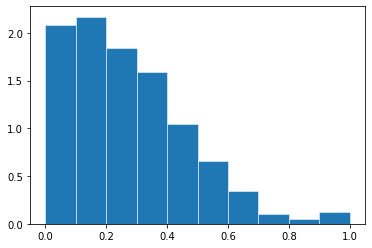

In [8]:
n, bins, _ = plt.hist(data['LGD'], bins=10, density=True, alpha = 1, linewidth=0.5, edgecolor='white')

In [9]:
#create extra column that would allow to do split in stratified fashion, bins are taken from the histogram
import numpy as np
data['stratification'] = 0
for index in range(len(bins)):
    data['stratification'] = np.where(data.LGD > bins[index], bins[index], data.stratification)

In [10]:
data.select_dtypes('object').columns

Index(['orign_qtr', 'flag_fthb', 'occpy_sts', 'channel', 'st', 'prop_type',
       'loan_purpose'],
      dtype='object')

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

X = data.drop(columns = ['LGD','legal_costs'], axis=1)
y = data['LGD']
# stratified fashion
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.3, random_state=0, stratify = data['stratification'] )
X_train1, X_val, y_train1, y_val  = train_test_split(X_train1, y_train1, test_size=0.25, random_state=1, stratify = X_train1['stratification'] ) # 0.25 x 0.8 = 0.2
# dropping the columns of 'stratification'
X_train1 = X_train1.drop(columns = ['stratification'], axis=1)
X_test1 = X_test1.drop(columns = ['stratification'], axis=1)
X_val = X_val.drop(columns = ['stratification'], axis=1)

# not stratified fashion
# X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.3, random_state=0)
# categorical features of the model
cat_features = ['orign_qtr', 'flag_fthb', 'occpy_sts', 'channel', 'st', 'prop_type', 'loan_purpose']
# Creating Pool
train_dataset = Pool(data = X_train1, label=y_train1, cat_features=cat_features)
test_dataset = Pool(data = X_test1, label=y_test1, cat_features=cat_features)
eval_dataset = Pool(data = X_val, label=y_val, cat_features = cat_features )

model = CatBoostRegressor(iterations=20000,
                          # custom_loss=[metrics.RMSE()],
                          eval_metric = 'R2',
                          
                          learning_rate=0.02,
                          # eval_metric='R2',

                          grow_policy = 'Depthwise', 
                          boosting_type = 'Plain',
                          logging_level='Silent',
                          task_type = 'GPU',
                          score_function = 'Cosine',
                          depth=5
                          )
                          # monotonicity constraints
                          # monotone_constraints = {'44':-1, '28':1, '23':-1}
                          # )


# Fit model
model.fit(train_dataset, eval_set = eval_dataset, plot=True)
# Get predictions
preds = model.predict(test_dataset)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Metric R2 is not implemented on GPU. Will use CPU for metric computation, this could significantly affect learning time


In [34]:
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score


# adjusted R^2 function

# def adj_r2(y_test1, preds):
#     return 1-(1-r2_score(y_test1, preds))*((len(X_test1)-1)/(len(X_test1)-len(X_test1.columns)-1))

def adj_r2(X_actual_test, y_actual_test, predictions):
    return 1-(1-r2_score(y_actual_test, predictions))*((len(X_actual_test)-1)/(len(X_actual_test)-len(X_actual_test.columns)-1))

#Training  results without any hyper search with RMSE as the loss function
print('Training: R^2 of the model', r2_score(y_train1, model.predict(train_dataset)))
print('Training: Adjusted R^2', adj_r2(X_train1, y_train1, model.predict(train_dataset)))
print('Training: RMSE of the model', (np.sqrt(mean_squared_error(y_train1, model.predict(train_dataset)))))
print('Training: MSE of the model', mean_squared_error(y_train1, model.predict(train_dataset)))

Training: R^2 of the model 0.8174900374308638
Training: Adjusted R^2 0.8034189745570528
Training: RMSE of the model 0.0848064985387362
Training: MSE of the model 0.007192142194400666


In [37]:
rmse_base_model_depthwise = (np.sqrt(mean_squared_error(y_test1, preds)))
r2_base_model_depthwise = r2_score(y_test1, preds)
print('Testing: R^2 of the model', r2)
print('Testing: Adjusted R^2', adj_r2(X_test1, y_test1, preds))
print('Testing: RMSE of the model', rmse)
print('Testing: MSE of the model', mean_squared_error(y_test1, preds))

Testing: R^2 of the model 0.4827207558728005
Testing: Adjusted R^2 0.4088237209974863
Testing: RMSE of the model 0.14017012707132054
Testing: MSE of the model 0.01964766452319015


In [38]:
# record the results
cell_list_train = worksheet.range('E4:H4')
cell_list_train[0].value =  r2_score(y_train1, model.predict(train_dataset))
cell_list_train[1].value =  adj_r2(X_train1, y_train1, model.predict(train_dataset))
cell_list_train[2].value = (np.sqrt(mean_squared_error(y_train1, model.predict(train_dataset))))
cell_list_train[3].value = mean_squared_error(y_train1, model.predict(train_dataset))
worksheet.update_cells(cell_list_train)

cell_list_test = worksheet.range('E5:H5')
cell_list_test[0].value =  r2_base_model_depthwise
cell_list_test[1].value =  adj_r2(X_test1, y_test1, preds)
cell_list_test[2].value = rmse_base_model_depthwise
cell_list_test[3].value = mean_squared_error(y_test1, preds)
worksheet.update_cells(cell_list_test)

{'spreadsheetId': '1wcW5n2BQW5xW35fvQmw51lt8DmGNPu7VPsuaYNagfMk',
 'updatedCells': 4,
 'updatedColumns': 4,
 'updatedRange': "'Лист1'!E5:H5",
 'updatedRows': 1}

In [27]:
# saving the model to json file
model.save_model(
    '/content/drive/My Drive/final_models/base_model_depthwise.json', #path to the model with datetime
    format="json",
    pool=train_dataset  # training dataset that is previously used for training
)

In [28]:
# Lossguide: by the number of leaves. Base model.
base_model_lossguide = CatBoostRegressor(iterations=20000,
                          # custom_loss=[metrics.RMSE()],
                          eval_metric = 'R2',
                          
                          learning_rate=0.02,
                          # eval_metric='R2',

                          grow_policy = 'Lossguide', 
                          boosting_type = 'Plain',
                          max_leaves = 31,
                          logging_level='Silent',
                          task_type = 'GPU',
                          score_function = 'Cosine',
                          depth=5
                          )



# Fit model
base_model_lossguide.fit(train_dataset, eval_set = eval_dataset, plot=True)
# Get predictions
base_model_lossguide_preds = base_model_lossguide.predict(test_dataset)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Metric R2 is not implemented on GPU. Will use CPU for metric computation, this could significantly affect learning time


In [29]:
# Results of Lossguide
print('Training: R^2 of the model', r2_score(y_train1, base_model_lossguide.predict(train_dataset)))
print('Training: Adjusted R^2', adj_r2(X_train1, y_train1, base_model_lossguide.predict(train_dataset)))
print('Training: RMSE of the model', (np.sqrt(mean_squared_error(y_train1, base_model_lossguide.predict(train_dataset)))))
print('Training: MSE of the model', mean_squared_error(y_train1, base_model_lossguide.predict(train_dataset)))

rmse_base_model_lossguide = (np.sqrt(mean_squared_error(y_test1, base_model_lossguide_preds)))
r2_base_model_lossguide = r2_score(y_test1, base_model_lossguide_preds)
print('Testing: R^2 of the model', r2_base_model_lossguide)
print('Testing: Adjusted R^2', adj_r2(X_test1, y_test1, base_model_lossguide_preds))
print('Testing: RMSE of the model', rmse_base_model_lossguide)
print('Testing: MSE of the model', mean_squared_error(y_test1, base_model_lossguide_preds))

Training: R^2 of the model 0.8782206697538466
Training: Adjusted R^2 0.8688317871498348
Training: RMSE of the model 0.06927437802267344
Training: MSE of the model 0.004798939450428262
Testing: R^2 of the model 0.48428350556168387
Testing: Adjusted R^2 0.41060972064192447
Testing: RMSE of the model 0.1399582332840924
Testing: MSE of the model 0.019588307064004433


In [39]:
# record the results
cell_list_train = worksheet.range('F5:I4')
cell_list_train[0].value =  r2_score(y_train1, base_model_lossguide.predict(train_dataset))
cell_list_train[1].value =  adj_r2(X_train1, y_train1, base_model_lossguide.predict(train_dataset))
cell_list_train[2].value = np.sqrt(mean_squared_error(y_train1, base_model_lossguide.predict(train_dataset)))
cell_list_train[3].value = mean_squared_error(y_train1, base_model_lossguide.predict(train_dataset))
worksheet.update_cells(cell_list_train)

cell_list_test = worksheet.range('J5:M5')
cell_list_test[0].value =  r2_base_model_lossguide
cell_list_test[1].value =  adj_r2(X_test1, y_test1, base_model_lossguide_preds)
cell_list_test[2].value = rmse_base_model_lossguide
cell_list_test[3].value = mean_squared_error(y_test1, base_model_lossguide_preds)
worksheet.update_cells(cell_list_test)

{'spreadsheetId': '1wcW5n2BQW5xW35fvQmw51lt8DmGNPu7VPsuaYNagfMk',
 'updatedCells': 4,
 'updatedColumns': 4,
 'updatedRange': "'Лист1'!J5:M5",
 'updatedRows': 1}

In [40]:
# saving the model to json file
base_model_lossguide.save_model(
    '/content/drive/My Drive/final_models/base_model_lossguide.json', #path to the model with datetime
    format="json",
    pool=train_dataset  # training dataset that is previously used for training
)

In [41]:
#Symmetric Trees. Base model.
base_model_symmetric = CatBoostRegressor(iterations=20000,
                          # custom_loss=[metrics.RMSE()],
                          eval_metric = 'R2',
                          
                          learning_rate=0.02,
                          # eval_metric='R2',

                          grow_policy = 'SymmetricTree', 
                          boosting_type = 'Plain',
                          depth = 6,
                          logging_level='Silent',
                          task_type = 'GPU',
                          score_function = 'Cosine',
                          )
# Fit model
base_model_symmetric.fit(train_dataset, eval_set = eval_dataset, plot=True)
# Get predictions
base_model_symmetric_preds = base_model_symmetric.predict(test_dataset)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Metric R2 is not implemented on GPU. Will use CPU for metric computation, this could significantly affect learning time


In [42]:
# Results of Symmetric Tree
print('Training: R^2 of the model', r2_score(y_train1,base_model_symmetric.predict(train_dataset)))
print('Training: Adjusted R^2', adj_r2(X_train1, y_train1, base_model_symmetric.predict(train_dataset)))
print('Training: RMSE of the model', (np.sqrt(mean_squared_error(y_train1, base_model_symmetric.predict(train_dataset)))))
print('Training: MSE of the model', mean_squared_error(y_train1, base_model_symmetric.predict(train_dataset)))

rmse_base_model_symmetric = (np.sqrt(mean_squared_error(y_test1, base_model_symmetric_preds)))
r2_base_model_symmetric = r2_score(y_test1, base_model_symmetric_preds)
print('Testing: R^2 of the model', r2_base_model_symmetric)
print('Testing: Adjusted R^2', adj_r2(X_test1, y_test1, base_model_symmetric_preds))
print('Testing: RMSE of the model', rmse_base_model_symmetric)
print('Testing: MSE of the model', mean_squared_error(y_test1, base_model_symmetric_preds))

Training: R^2 of the model 0.5686697762067686
Training: Adjusted R^2 0.5354152918326873
Training: RMSE of the model 0.13037393984591505
Training: MSE of the model 0.01699736419094628
Testing: R^2 of the model 0.3972819866305408
Testing: Adjusted R^2 0.3111794132920467
Testing: RMSE of the model 0.1513038665180386
Testing: MSE of the model 0.022892860023308436


In [49]:
# record the results
from IPython.display import clear_output
cell_list_train = worksheet.range('F6:I6')
cell_list_train[0].value =  r2_score(y_train1,base_model_symmetric.predict(train_dataset))
cell_list_train[1].value =  adj_r2(X_train1, y_train1, base_model_symmetric.predict(train_dataset))
cell_list_train[2].value = np.sqrt(mean_squared_error(y_train1, base_model_symmetric.predict(train_dataset)))
cell_list_train[3].value = mean_squared_error(y_train1, base_model_symmetric.predict(train_dataset))
worksheet.update_cells(cell_list_train)

cell_list_test = worksheet.range('J6:M6')
cell_list_test[0].value =  r2_base_model_symmetric
cell_list_test[1].value =  adj_r2(X_test1, y_test1, base_model_symmetric_preds)
cell_list_test[2].value = rmse_base_model_symmetric
cell_list_test[3].value = mean_squared_error(y_test1, base_model_symmetric_preds)
worksheet.update_cells(cell_list_test)
clear_output()

In [47]:
# saving the model to json file
base_model_symmetric.save_model(
    '/content/drive/My Drive/final_models/base_model_symmetric.json', #path to the model with datetime
    format="json",
    pool=train_dataset  # training dataset that is previously used for training
)